In [32]:
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, precision_score, recall_score, roc_curve, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay, balanced_accuracy_score
from sklearn.linear_model import LogisticRegressionxa



# load data

In [33]:
df_profiles = pd.read_csv('./data/profiles.csv')
print(df_profiles.shape)
print(df_profiles.info())
df_profiles.head()

(4904, 11)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4904 entries, 0 to 4903
Data columns (total 11 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       4904 non-null   int64  
 1   is_closed                4904 non-null   bool   
 2   city                     3558 non-null   float64
 3   sex                      4904 non-null   int64  
 4   followers_count          3780 non-null   float64
 5   schools                  2025 non-null   object 
 6   schools_years_grad       2025 non-null   object 
 7   universities             2025 non-null   object 
 8   universities_years_grad  2025 non-null   object 
 9   faculties                2025 non-null   object 
 10  careers                  2025 non-null   object 
dtypes: bool(1), float64(2), int64(2), object(6)
memory usage: 388.0+ KB
None


,id,is_closed,city,sex,followers_count,schools,schools_years_grad,universities,universities_years_grad,faculties,careers
0,1119,False,2.0,2,1256.0,NaN,NaN,NaN,NaN,NaN,NaN
1,1127,False,2.0,2,2738.0,"['12', '3447', '59']","[2005, None, None]","[53, 53, 53]","[2011, 2014, 2012]","[201, 201, 169574]","[None, None, None, None, None, None, None]"
2,2619,True,2.0,2,NaN,"['54', '1319']","[2005, None]","[1, 29, 1]","[2010, 2011, 2013]","[7, 1815, 7]",[]
3,2767,False,2.0,2,446.0,"['12', '6972', '969864']","[2005, 2001, 1996]",[53],[2011],[201],[]
4,4023,False,2.0,2,462.0,"['54054', '11301']","[2002, 2002]","[53, 53]","[2008, 2011]","[202, 208]","[94, 94, None]"


In [34]:
user_ids = df_profiles['id']
print(user_ids.info())

friends_storage = dict((id, set()) for id in user_ids)
print(friends_storage)

<class 'pandas.core.series.Series'>
RangeIndex: 4904 entries, 0 to 4903
Series name: id
Non-Null Count  Dtype
--------------  -----
4904 non-null   int64
dtypes: int64(1)
memory usage: 38.4 KB
None
{1119: set(), 1127: set(), 2619: set(), 2767: set(), 4023: set(), 18239: set(), 18944: set(), 21825: set(), 57771: set(), 59041: set(), 75355: set(), 76255: set(), 86100: set(), 137125: set(), 159620: set(), 163584: set(), 170349: set(), 193772: set(), 197440: set(), 209965: set(), 217487: set(), 259050: set(), 273687: set(), 275647: set(), 276830: set(), 317799: set(), 325300: set(), 344715: set(), 351122: set(), 401359: set(), 431301: set(), 484792: set(), 499787: set(), 621956: set(), 641991: set(), 669094: set(), 697679: set(), 715957: set(), 738850: set(), 782512: set(), 791498: set(), 852898: set(), 955206: set(), 960578: set(), 1010174: set(), 1077823: set(), 1133684: set(), 1219966: set(), 1273239: set(), 1306574: set(), 1320705: set(), 1363224: set(), 1397481: set(), 1444702: set(),

## Load friends

In [35]:
df_friends = pd.read_csv('./data/friends.csv')
print(df_friends.info())
df_friends.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 953179 entries, 0 to 953178
Data columns (total 2 columns):
 #   Column  Non-Null Count   Dtype
---  ------  --------------   -----
 0   user1   953179 non-null  int64
 1   user2   953179 non-null  int64
dtypes: int64(2)
memory usage: 14.5 MB
None


,user1,user2
0,1119,9216
1,1119,3580931
2,1119,6055941
3,1119,425991
4,1119,1032


In [36]:
df_friends_train = pd.read_csv('./data/links_train.csv')
print(df_friends_train.info())
df_friends_train.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6356754 entries, 0 to 6356753
Data columns (total 3 columns):
 #   Column      Dtype
---  ------      -----
 0   user1       int64
 1   user2       int64
 2   is_friends  int64
dtypes: int64(3)
memory usage: 145.5 MB
None


,user1,user2,is_friends
0,82530889,157814259,0
1,104274145,669799766,0
2,227438304,268462283,0
3,782512,66408174,0
4,164821380,188883374,0


In [37]:
for index, row in df_friends_train.iterrows():
    user1 = row['user1']
    user2 = row['user2']
    is_friends = row['is_friends']

    if is_friends == 1:
        if user1 in friends_storage:
            friends_storage[user1].add(user2)
        else:
            print("warning: can't find id by user1 in storage")
        if user2 in friends_storage:
            friends_storage[user2].add(user1)
        else:
            print("warning: can't find id by user1 in storage")

print(len(friends_storage))

4904


In [38]:
## Append small data

for index, row in df_friends.iterrows():
    user1 = row['user1']
    user2 = row['user2']

    if user1 in friends_storage:
        friends_storage[user1].add(user2)
    else:
        print("warning: can't find id by user1 in storage")
    if user2 in friends_storage:
        friends_storage[user2].add(user1)
    else:
        friends_storage[user2] = set()
        friends_storage[user2].add(user1)
        print("warning: can't find id by user2 in storage")
        
print(len(friends_storage))

671789


## Test simple algo : 2-friends

In [39]:
df_friends_test = pd.read_csv('./data/links_test.csv')
print(df_friends_test.info())
df_friends_test.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 706407 entries, 0 to 706406
Data columns (total 3 columns):
 #   Column  Non-Null Count   Dtype
---  ------  --------------   -----
 0   ID      706407 non-null  int64
 1   user1   706407 non-null  int64
 2   user2   706407 non-null  int64
dtypes: int64(3)
memory usage: 16.2 MB
None


,ID,user1,user2
0,0,426512423,767230291
1,1,127744839,589283004
2,2,76324543,189101836
3,3,79828756,272293999
4,4,88063046,280460807


In [40]:
def is_friends_simple_2fr(user1, user2):
    user1_fr = friends_storage[user1]
    user2_fr = friends_storage[user2]
    fr = user1_fr & user2_fr
    if len(fr) >= 2:
        return True
    return False

out_simple_2fr = []
for index, row in df_friends_test.iterrows():
    id = row['ID']
    user1 = row['user1']
    user2 = row['user2']

    if is_friends_simple_2fr(user1, user2):
        out_simple_2fr.append([1])
    else:
        out_simple_2fr.append([0])

print(len(out_simple_2fr))

df_out_simple_2fr = pd.DataFrame(np.array(out_simple_2fr), columns=['is_friends'])
print(df_out_simple_2fr.info())

df_out_simple_2fr.to_csv('./out/df_out_simple_2fr.csv', encoding='utf-8')

706407
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 706407 entries, 0 to 706406
Data columns (total 1 columns):
 #   Column      Non-Null Count   Dtype
---  ------      --------------   -----
 0   is_friends  706407 non-null  int64
dtypes: int64(1)
memory usage: 5.4 MB
None


## Test 2_fr + uni

In [41]:
df_profiles = pd.read_csv('./data/profiles.csv')
print(df_profiles.info())
df_profiles.head(10)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4904 entries, 0 to 4903
Data columns (total 11 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       4904 non-null   int64  
 1   is_closed                4904 non-null   bool   
 2   city                     3558 non-null   float64
 3   sex                      4904 non-null   int64  
 4   followers_count          3780 non-null   float64
 5   schools                  2025 non-null   object 
 6   schools_years_grad       2025 non-null   object 
 7   universities             2025 non-null   object 
 8   universities_years_grad  2025 non-null   object 
 9   faculties                2025 non-null   object 
 10  careers                  2025 non-null   object 
dtypes: bool(1), float64(2), int64(2), object(6)
memory usage: 388.0+ KB
None


,id,is_closed,city,sex,followers_count,schools,schools_years_grad,universities,universities_years_grad,faculties,careers
0,1119,False,2.0,2,1256.0,NaN,NaN,NaN,NaN,NaN,NaN
1,1127,False,2.0,2,2738.0,"['12', '3447', '59']","[2005, None, None]","[53, 53, 53]","[2011, 2014, 2012]","[201, 201, 169574]","[None, None, None, None, None, None, None]"
2,2619,True,2.0,2,NaN,"['54', '1319']","[2005, None]","[1, 29, 1]","[2010, 2011, 2013]","[7, 1815, 7]",[]
3,2767,False,2.0,2,446.0,"['12', '6972', '969864']","[2005, 2001, 1996]",[53],[2011],[201],[]
4,4023,False,2.0,2,462.0,"['54054', '11301']","[2002, 2002]","[53, 53]","[2008, 2011]","[202, 208]","[94, 94, None]"
5,18239,False,2.0,2,1887.0,['1739'],[None],[53],[None],[202],"[94, 76139618]"
6,18944,False,2.0,1,4933.0,['619'],[None],[68],[2011],[327],[]
7,21825,True,2.0,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,57771,True,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,59041,True,2.0,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [50]:
def eval_list(exp):
    try:
        return eval(str(exp).split('\n')[0].split('    ')[-1])
    except:
        return [-1]

def has_university(user1, user2):
    u1_row = df_profiles.loc[(df_profiles['id'] == user1)]
    u1_universities = eval_list(u1_row['universities'])

    u2_row = df_profiles.loc[(df_profiles['id'] == user2)]
    u2_universities = eval_list(u2_row['universities'])

    for un in u1_universities:
        if un != -1:
            if un in u2_universities:
                return True
    return False

def has_school(user1, user2):
    u1_row = df_profiles.loc[(df_profiles['id'] == user1)]
    u1_schools = eval_list(u1_row['schools'])

    u2_row = df_profiles.loc[(df_profiles['id'] == user2)]
    u2_schools = eval_list(u2_row['schools'])

    for un in u1_schools:
        if un != -1:
            if un in u2_schools:
                return True
    return False


def is_friends_simple_2fr(user1, user2):
    user1_fr = friends_storage[user1]
    user2_fr = friends_storage[user2]
    fr = user1_fr & user2_fr
    if len(fr) >= 2:
        return True
    return False

def is_friends_simple_3fr(user1, user2):
    user1_fr = friends_storage[user1]
    user2_fr = friends_storage[user2]
    fr = user1_fr & user2_fr
    if len(fr) >= 3:
        return True
    return False

def is_close_profile(user):
    u_row = df_profiles.loc[(df_profiles['id'] == user)]
    closed = eval_list(u_row['is_closed'])
    return closed

print(is_close_profile(2767))
is_close_profile(2619)

False


True

In [52]:
out_simple_2fr_plus_uni = []
for index, row in df_friends_test.iterrows():
    id = row['ID']
    user1 = row['user1']
    user2 = row['user2']
    if (is_close_profile(user1) or is_close_profile(user2)) and (not is_friends_simple_3fr(user1, user2)):
        out_simple_2fr_plus_uni.append([0])
    elif is_friends_simple_2fr(user1, user2):
        out_simple_2fr_plus_uni.append([1])
    elif has_university(user1, user2) and has_school(user1, user2):
        out_simple_2fr_plus_uni.append([1])
    else:
        out_simple_2fr_plus_uni.append([0])

print(len(out_simple_2fr_plus_uni))

df_out_simple_2fr_plus_uni = pd.DataFrame(np.array(out_simple_2fr_plus_uni), columns=['is_friends'])
print(df_out_simple_2fr_plus_uni.info())

df_out_simple_2fr_plus_uni.to_csv('./out/df_out_simple_2fr_plus_uni_close.csv', encoding='utf-8')

706407
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 706407 entries, 0 to 706406
Data columns (total 1 columns):
 #   Column      Non-Null Count   Dtype
---  ------      --------------   -----
 0   is_friends  706407 non-null  int64
dtypes: int64(1)
memory usage: 5.4 MB
None


# make features

In [ ]:
user2friends = df_friends.groupby('user1').user2.apply(set).to_dict()

In [ ]:
def calc_feature(user1: int, user2: int) -> float:
    return np.random.random()

In [ ]:
records = []
users = sorted(set(df_friends.user1.tolist()))
for i, u1 in tqdm(enumerate(users), total=len(users)):
    for j, u2 in enumerate(users):
        if j <= i: 
            continue
        records.append((
            u1, 
            u2,
            calc_feature(u1, u2)
        ))
        
df = pd.DataFrame(records, columns=['user1', 'user2', 'your_feature_name'])

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3759/3759 [00:03<00:00, 973.25it/s]


In [ ]:
print(len(df))
df.head(3)

7063161


,user1,user2,your_feature_name
0,1119,1127,0.860916
1,1119,2619,0.018310
2,1119,2767,0.652498


# evaluate model

In [ ]:
links_train = pd.read_csv('processed/links_train.csv')
links_test = pd.read_csv('processed/links_test.csv')

len(links_train), len(links_test)

(6356754, 706407)

In [ ]:
train = links_train.merge(df, on=['user1', 'user2'], how='inner')
print(len(train))
train.head(3)

6356754


,user1,user2,is_friends,your_feature_name
0,82530889,157814259,0,0.795680
1,104274145,669799766,0,0.985787
2,227438304,268462283,0,0.158391


In [ ]:
train, valid = train_test_split(train, test_size=0.2, stratify=train.is_friends)

In [ ]:
test = links_test.merge(df, on=['user1', 'user2'], how='inner')
print(len(test))
test.head(3)

706407


,ID,user1,user2,your_feature_name
0,0,426512423,767230291,0.209695
1,1,127744839,589283004,0.083597
2,2,76324543,189101836,0.123471


In [ ]:
features = [
    'your_feature_name'
]
target = 'is_friends'

In [ ]:
model = LogisticRegression()
model = model.fit(train[features], train[target])

preds_train = model.predict_proba(train[features])
gt_train = train[target]

preds_valid = model.predict_proba(valid[features])
gt_valid = valid[target]

In [ ]:
balanced_accuracy_score(gt_train, preds_train.argmax(axis=1))

0.5

# calc metrics

/Users/i.shamov/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/i.shamov/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


prec train: 0.000 valid: 0.000
recall train: 0.000 valid: 0.000
f1 train: 0.000 valid: 0.000
roc auc train: 0.503 valid: 0.501

balanced acc train: 0.500 valid: 0.500


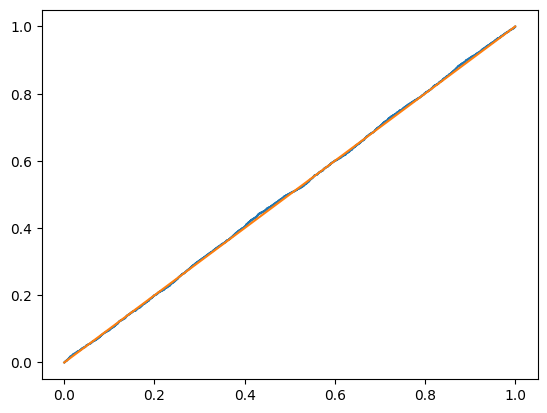

In [ ]:
# params = dict(average='weighted')
params = dict()

print(f'prec train: {precision_score(gt_train, preds_train.argmax(axis=1), **params):.3f} valid: {precision_score(gt_valid, preds_valid.argmax(axis=1), **params):.3f}')
print(f'recall train: {recall_score(gt_train, preds_train.argmax(axis=1), **params):.3f} valid: {recall_score(gt_valid, preds_valid.argmax(axis=1), **params):.3f}')
print(f'f1 train: {f1_score(gt_train, preds_train.argmax(axis=1), **params):.3f} valid: {f1_score(gt_valid, preds_valid.argmax(axis=1), **params):.3f}')
print(f'roc auc train: {roc_auc_score(gt_train, preds_train[:, 1], **params):.3f} valid: {roc_auc_score(gt_valid, preds_valid[:, 1], **params):.3f}')

print(f'\nbalanced acc train: {balanced_accuracy_score(gt_train, preds_train.argmax(axis=1)):.3f} valid: {balanced_accuracy_score(gt_valid, preds_valid.argmax(axis=1)):.3f}')

fpr, tpr, tr = roc_curve(valid[target], preds_valid[:, 1])
_ = plt.plot(fpr, tpr)
_ = plt.plot((0, 1), (0, 1))

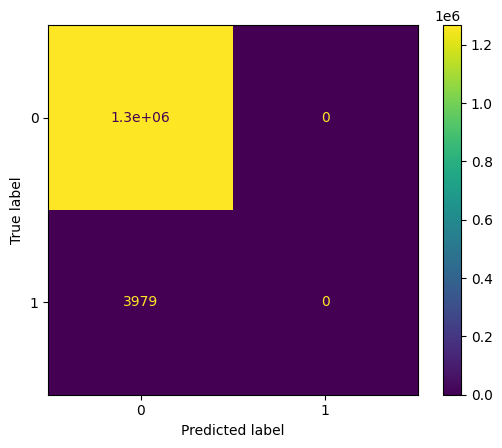

In [ ]:
ConfusionMatrixDisplay(confusion_matrix(valid[target], preds_valid.argmax(axis=1))).plot()

# make solution

In [ ]:
test_pred = model.predict_proba(test[features]).argmax(axis=1)
print('friends percentage: ', sum(test_pred) / len(test_pred))

friends percentage:  0.0


In [ ]:
test_pred = test[['user1', 'user2']].assign(is_friends=test_pred)
test_pred.assign(ID=list(range(len(test_pred))))[['ID', 'is_friends']].to_csv('pred.csv', index=False)